In [112]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import anndata as ad
import scanpy as sc

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from umap import UMAP

from scroutines import powerplots

In [110]:
# functions (the teacher wrote for you to use later)
def rot2d(x, y, theta, unit='degree'):
    """ rotate data points defined by `x` and `y` by `theta` degree
    """
    a = np.vstack([x,y]).T
    if unit == 'degree':
        theta = theta*np.pi/180 # convert to radian

    R = np.array([[np.cos(theta), -np.sin(theta)], [np.sin(theta), np.cos(theta)]])
    ar = a.dot(R.T)
    return ar[:,0], ar[:,1]

def st_scatter(x, y, gexp=None, vmax_p=98, title='', s=1, cbar_label='', output='', cmap='rocket_r', axis_off=True):
    """customized scatter plot -- yesterday's progress
    """
  
    fig, ax = plt.subplots(figsize=(10,8))
    if gexp is not None:
        vmax = np.percentile(gexp, vmax_p)
        g = ax.scatter(x, y, c=gexp, s=s, edgecolor='none', vmax=vmax, cmap=cmap, rasterized=True)
        fig.colorbar(g, label=cbar_label, shrink=0.3)
    else:
        g = ax.scatter(x, y, s=s, edgecolor='none', cmap=cmap, rasterized=True)
  
    if axis_off:
        ax.axis('off')
    ax.set_title(title)
    ax.set_aspect('equal')
  
    if output:
        powerplots.savefig_autodate(fig, output)
        
    return 

# visualize clusters
def plot_cluster(clsts, x, y, ux, uy, s=1, axis_off=True):
    """this assumes `clsts` is a integer that starts from 0
    """
    from matplotlib import colors
  
    unq_clsts, inv = np.unique(clsts, return_inverse=True)
    n_unq = len(unq_clsts)
    # colors = np.array(sns.color_palette('husl', n_unq))
    # c_vec = colors[inv]
  
    cmap = plt.cm.jet
    norm = colors.BoundaryNorm(np.arange(-0.5, n_unq, 1), cmap.N)
  
    fig, axs = plt.subplots(1, 2, figsize=(8*2,6))
    
    ax = axs[0]
    g = ax.scatter(x, y, norm=norm, cmap=cmap, c=clsts, s=s, edgecolor='none')
    ax.set_title('XY (spatial distribution)')
    ax.set_aspect('equal')
    if axis_off:
        ax.axis('off')
    
    ax = axs[1]
    ax.scatter(ux, uy, norm=norm, cmap=cmap, c=clsts, s=s, edgecolor='none')
    ax.set_title('UMAP (molecular similarity)')
    ax.set_aspect('equal')
    if axis_off:
        ax.axis('off')
  
    fig.colorbar(g, ax=ax, label='clusters', ticks=np.arange(n_unq), shrink=0.7)
    return fig, axs

In [3]:
outdir = "/data/qlyu/v1/results_merfish/plots_230621"
outdatadir = "/data/qlyu/v1/results_merfish"
!mkdir -p $outdir

In [4]:
adata = ad.read('/data/qlyu/v1/results_merfish/ant_reg0_230622.h5ad')
adata

AnnData object with n_obs × n_vars = 83226 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass'
    obsm: 'blanks'

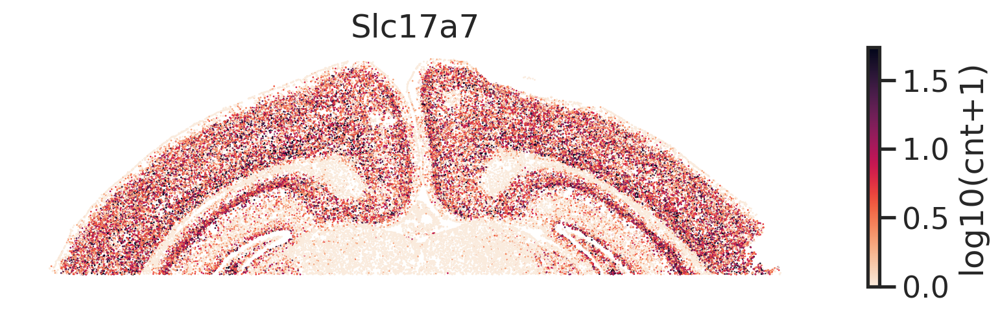

In [12]:
gn = 'Slc17a7'
xr = adata.obs['x']
yr = adata.obs['y']
g = np.log10(1+adata[:,gn].X)
st_scatter(xr, yr, gexp=g, title=gn, cbar_label='log10(cnt+1)', axis_off=True)

# norm

In [6]:
cnts = adata.X
cov = np.sum(cnts, axis=1)
medcov = np.median(cov)

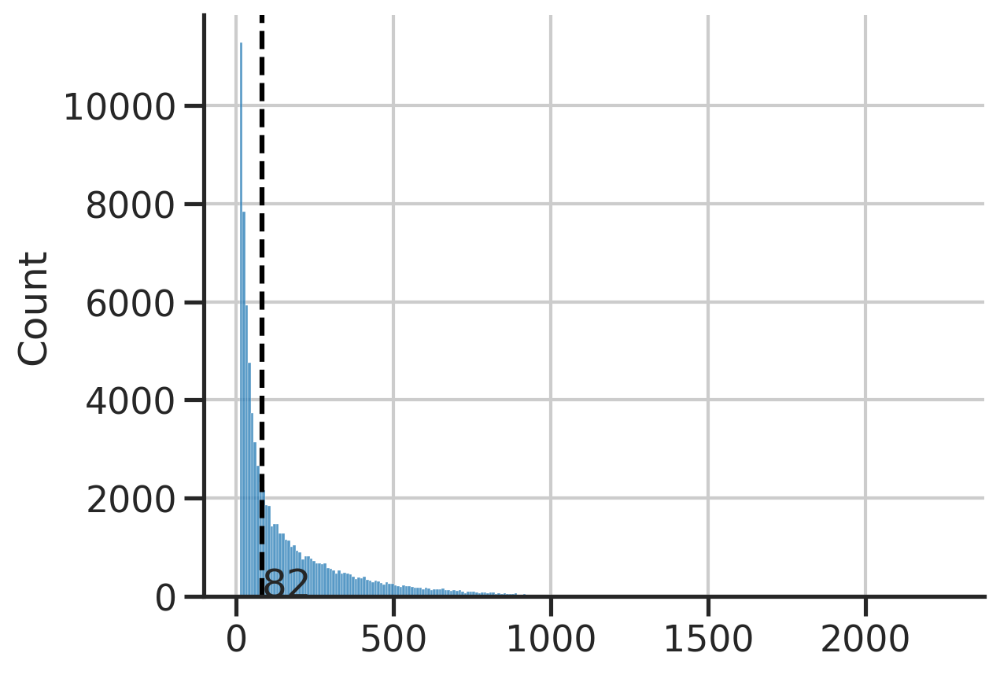

In [7]:
fig, ax = plt.subplots()
sns.histplot(cov, ax=ax)
ax.text(medcov, 0, int(medcov))
ax.axvline(medcov, color='k', linestyle='--')
sns.despine(ax=ax)
plt.show()

In [10]:
# equlize the counts for all cells to be 100
scaling = 100
normcnts = cnts/cov.reshape(-1,1)*100
adata.layers['norm'] = normcnts

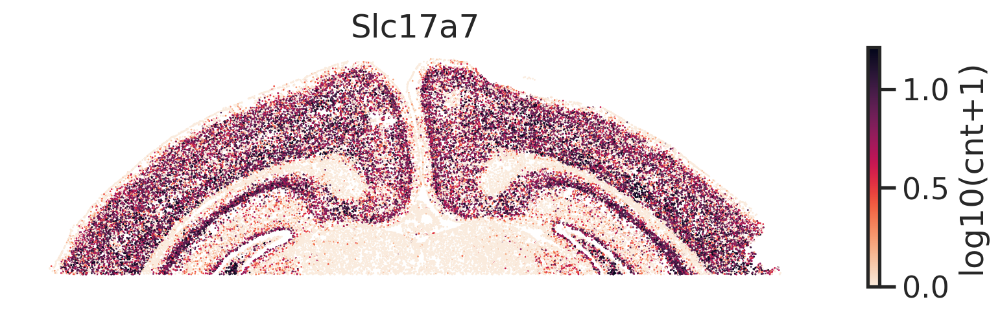

In [13]:
gn = 'Slc17a7'
xr = adata.obs['x']
yr = adata.obs['y']
g = np.log10(1+adata[:,gn].layers['norm'])
st_scatter(xr, yr, gexp=g, title=gn, cbar_label='log10(cnt+1)', axis_off=True)

# PCA, UMAP, clustering

In [32]:
pca = PCA(n_components=20)
pcs = pca.fit_transform(adata.layers['norm'])
print(pcs.shape)

ucs = UMAP(n_components=2, n_neighbors=30).fit_transform(pcs)
print(ucs.shape)

(83226, 20)
(83226, 2)


In [33]:
adata.obsm['pca'] = pcs
adata.obsm['umap'] = ucs

In [37]:
sc.pp.neighbors(adata, n_neighbors=30, use_rep='pca')

In [48]:
r = 0.1
sc.tl.leiden(adata, resolution=r, key_added=f'leiden_r{r}')

In [41]:
adata

AnnData object with n_obs × n_vars = 83226 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'leiden'
    uns: 'neighbors', 'leiden'
    obsm: 'blanks', 'X_pca', 'pca', 'umap'
    layers: 'normX', 'norm'
    obsp: 'distances', 'connectivities'

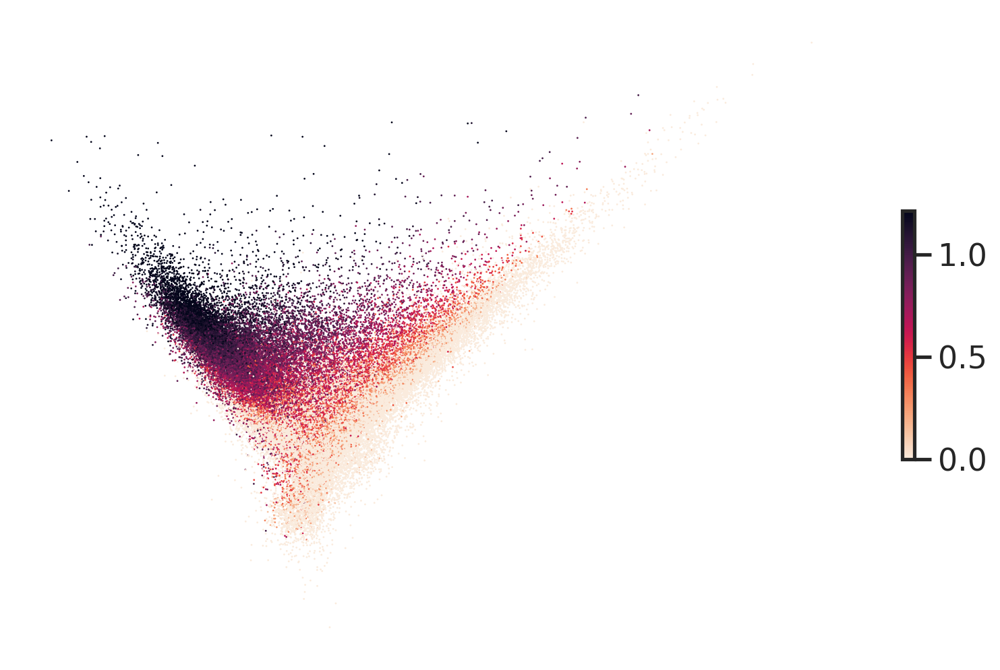

In [38]:
st_scatter(pcs[:,0], pcs[:,1], gexp=g)

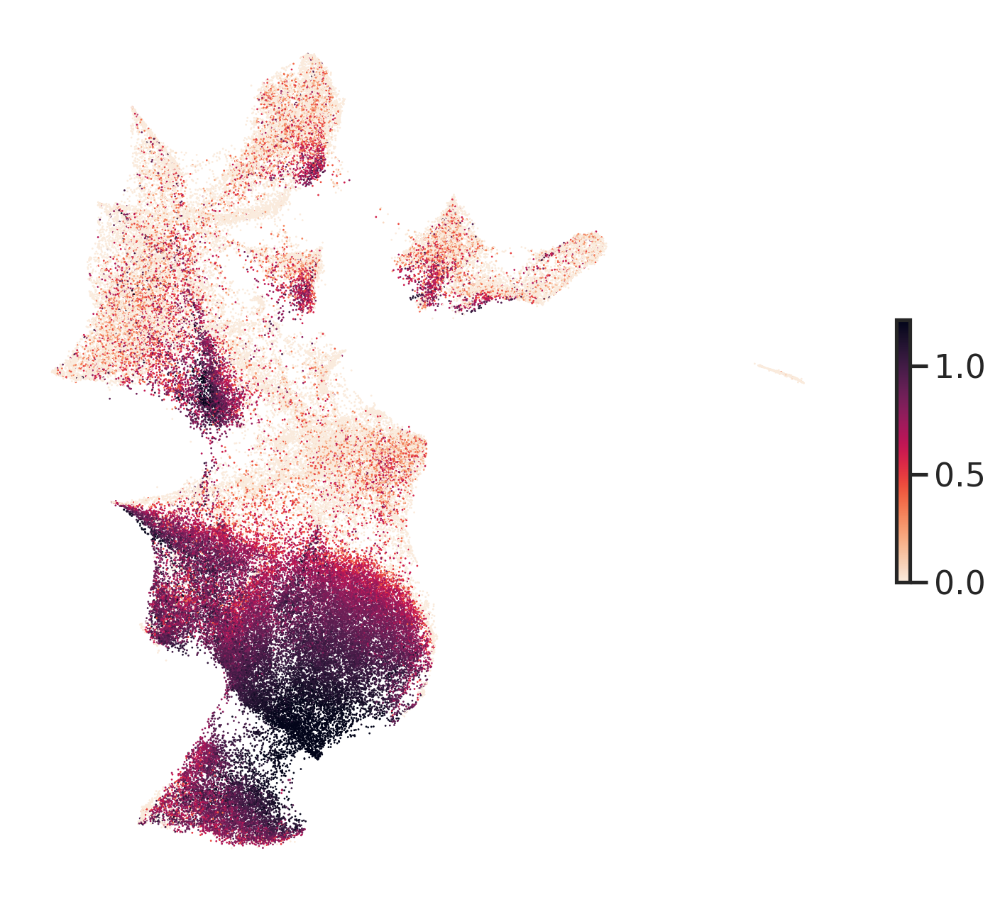

In [39]:
st_scatter(ucs[:,0], ucs[:,1], gexp=g)

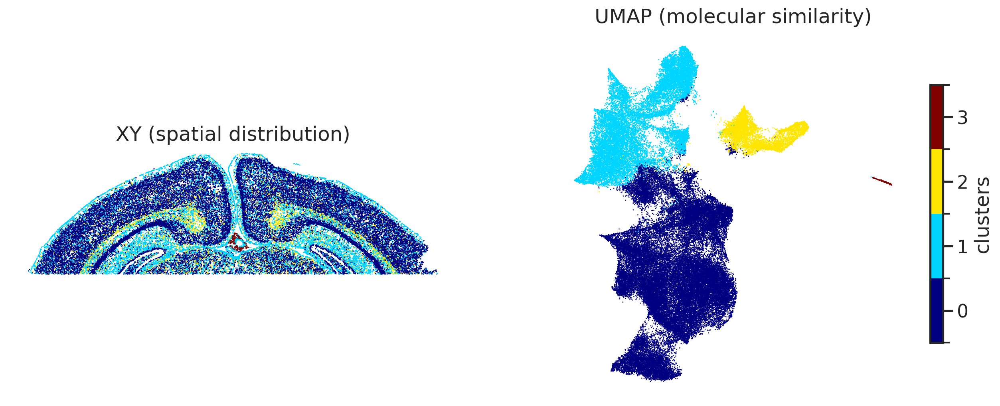

In [64]:
clsts = adata.obs['leiden_r0.1'].astype(int)
x = adata.obs['x']
y = adata.obs['y']
ux = adata.obsm['umap'][:,0]
uy = adata.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy)

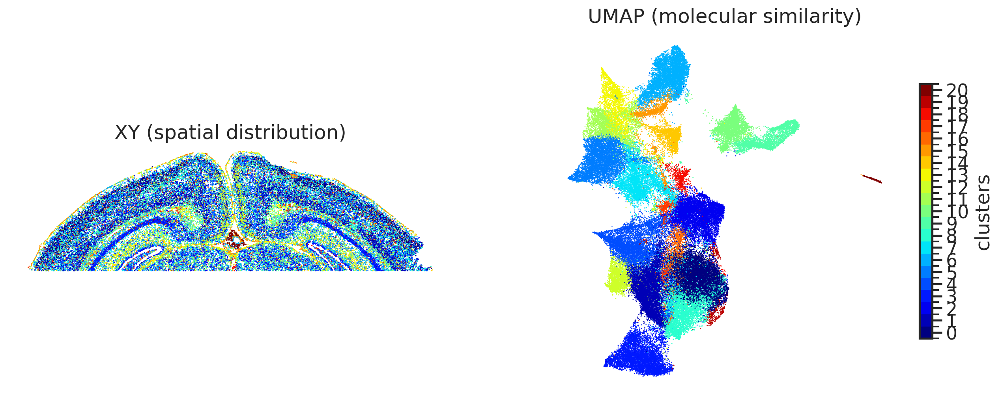

In [65]:
clsts = adata.obs['leiden'].astype(int)
x = adata.obs['x']
y = adata.obs['y']
ux = adata.obsm['umap'][:,0]
uy = adata.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy)

# one cluster at a time - and makse sense of them
- pick cluster 0

In [71]:
adatasub = adata[adata.obs['leiden_r0.1']=='0']
adatasub = adata[adata.obs['x']<4500].copy()
adatasub

AnnData object with n_obs × n_vars = 29238 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'leiden', 'leiden_r0.1'
    uns: 'neighbors', 'leiden'
    obsm: 'blanks', 'X_pca', 'pca', 'umap'
    layers: 'normX', 'norm'
    obsp: 'distances', 'connectivities'

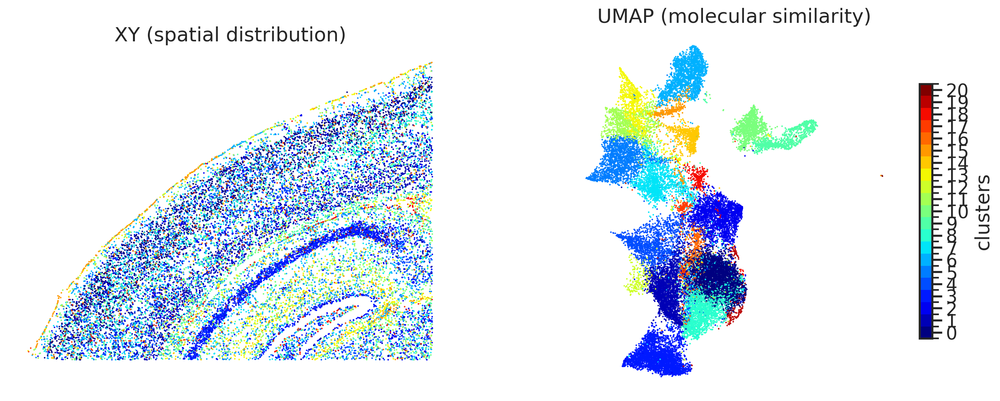

In [70]:
clsts = adatasub.obs['leiden'].astype(int)
x = adatasub.obs['x']
y = adatasub.obs['y']
ux = adatasub.obsm['umap'][:,0]
uy = adatasub.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, s=2)

In [73]:
pca = PCA(n_components=20)
pcs = pca.fit_transform(adatasub.layers['norm'])
print(pcs.shape)

ucs = UMAP(n_components=2, n_neighbors=30).fit_transform(pcs)
print(ucs.shape)

(29238, 20)
(29238, 2)


In [74]:
adatasub.obsm['pca'] = pcs
adatasub.obsm['umap'] = ucs

In [77]:
sc.pp.neighbors(adatasub, n_neighbors=30, use_rep='pca')

In [78]:
r = 0.1
sc.tl.leiden(adatasub, resolution=r, key_added=f'leiden_r{r}')

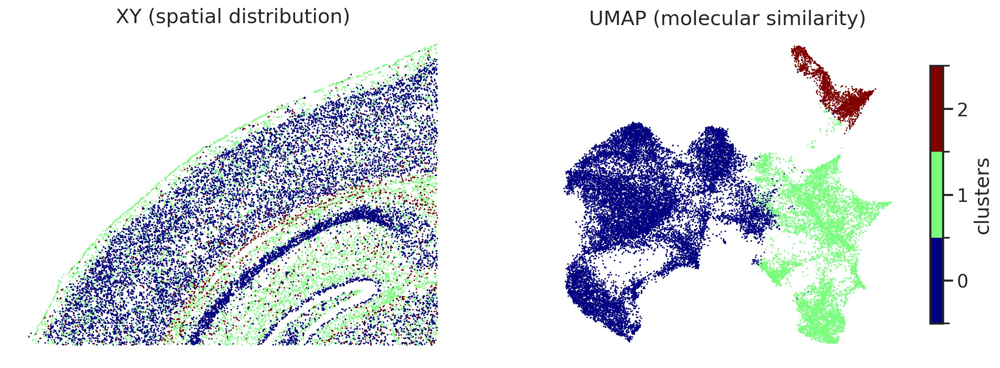

In [79]:
clsts = adatasub.obs['leiden_r0.1'].astype(int)
x = adatasub.obs['x']
y = adatasub.obs['y']
ux = adatasub.obsm['umap'][:,0]
uy = adatasub.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, s=2)

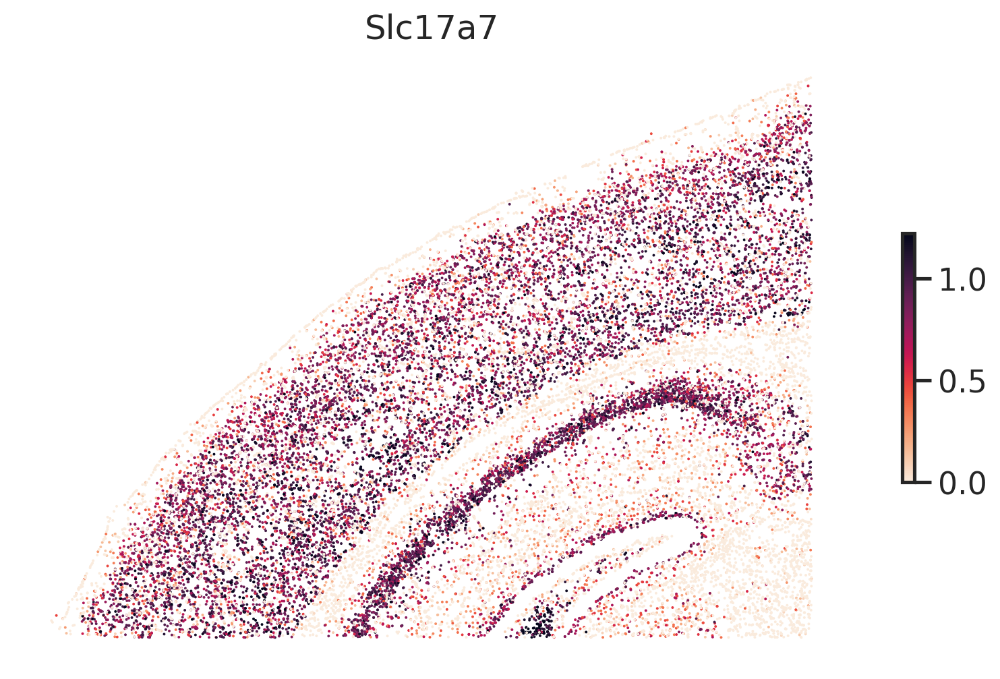

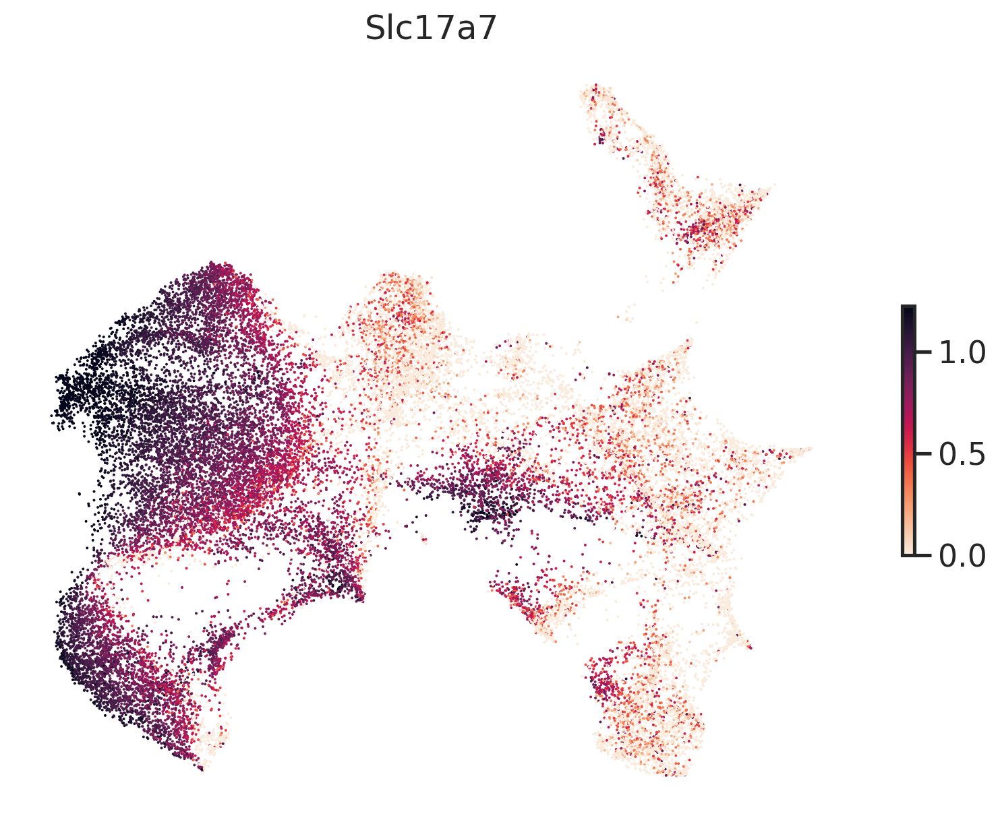

In [86]:
g = np.log10(1+adatasub[:,gn].layers['norm'])
st_scatter(x, y, gexp=g, s=2, title=gn)
st_scatter(ux, uy, gexp=g, s=2, title=gn)

# one cluster at a time - and makse sense of them
- pick cluster 0

In [94]:
adatasub2 = adatasub[adatasub.obs['leiden_r0.1']=='0'].copy()
# adatasub2 = adatasub[adatasub.obs['x']<4500].copy()
adatasub2

AnnData object with n_obs × n_vars = 19215 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'leiden', 'leiden_r0.1'
    uns: 'neighbors', 'leiden'
    obsm: 'blanks', 'X_pca', 'pca', 'umap'
    layers: 'normX', 'norm'
    obsp: 'distances', 'connectivities'

In [95]:
pca = PCA(n_components=20)
pcs = pca.fit_transform(adatasub2.layers['norm'])
print(pcs.shape)

ucs = UMAP(n_components=2, n_neighbors=30).fit_transform(pcs)
print(ucs.shape)

(19215, 20)
(19215, 2)


In [96]:
adatasub2.obsm['pca'] = pcs
adatasub2.obsm['umap'] = ucs

In [97]:
sc.pp.neighbors(adatasub2, n_neighbors=30, use_rep='pca')

In [98]:
r = 0.1
sc.tl.leiden(adatasub2, resolution=r, key_added=f'leiden_r{r}')

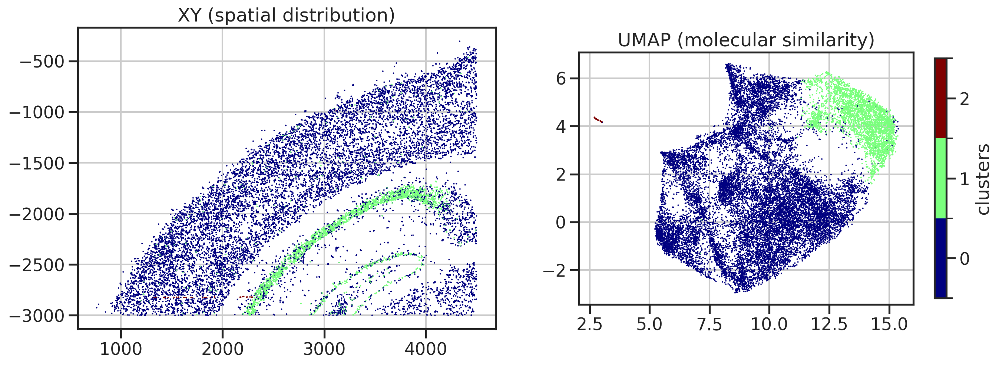

In [113]:
clsts = adatasub2.obs['leiden_r0.1'].astype(int)
x = adatasub2.obs['x']
y = adatasub2.obs['y']
ux = adatasub2.obsm['umap'][:,0]
uy = adatasub2.obsm['umap'][:,1]
fig, axs = plot_cluster(clsts, x, y, ux, uy, s=2, axis_off=False)
# axs[0].plot([2000,4500], [-3000,-1500])

# one cluster at a time - and makse sense of them
- pick cluster 0

In [102]:
adatasub3 = adatasub2[adatasub2.obs['leiden_r0.1']=='0'].copy()
# adatasub2 = adatasub[adatasub.obs['x']<4500].copy()
adatasub3

AnnData object with n_obs × n_vars = 15798 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'leiden', 'leiden_r0.1'
    uns: 'neighbors', 'leiden'
    obsm: 'blanks', 'X_pca', 'pca', 'umap'
    layers: 'normX', 'norm'
    obsp: 'distances', 'connectivities'

In [126]:
xy  = adatasub3.obs[['x', 'y']].values
adatasub3.obsm['xy'] = xy
sc.pp.neighbors(adatasub3, n_neighbors=100, use_rep='xy')

In [130]:
r = 0.01
sc.tl.leiden(adatasub3, resolution=r, key_added=f'leiden_spatial_r{r}')

(<Figure size 1600x600 with 3 Axes>,
 array([<Axes: title={'center': 'XY (spatial distribution)'}>,
        <Axes: title={'center': 'UMAP (molecular similarity)'}>],
       dtype=object))

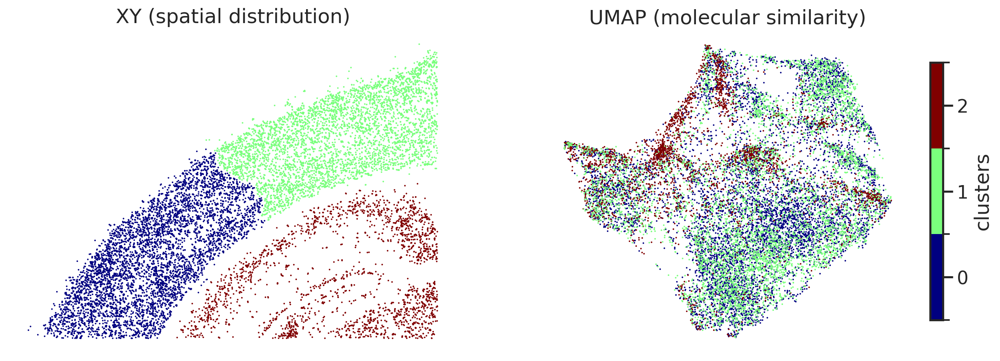

In [131]:
clsts = adatasub3.obs[f'leiden_spatial_r{r}'].astype(int)
x  = adatasub3.obs['x']
y  = adatasub3.obs['y']
ux = adatasub3.obsm['umap'][:,0]
uy = adatasub3.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, s=2,)

# one cluster at a time - and makse sense of them
- pick cluster 0

In [134]:
adatasub4 = adatasub3[adatasub3.obs['leiden_spatial_r0.01'].isin(['0', '1'])].copy()
adatasub4

AnnData object with n_obs × n_vars = 13241 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'leiden', 'leiden_r0.1', 'leiden_r0.2', 'leiden_spatial_r0.2', 'leiden_spatial_r0.1', 'leiden_spatial_r0.01'
    uns: 'neighbors', 'leiden'
    obsm: 'blanks', 'X_pca', 'pca', 'umap', 'xy'
    layers: 'normX', 'norm'
    obsp: 'distances', 'connectivities'

In [135]:
pca = PCA(n_components=20)
pcs = pca.fit_transform(adatasub4.layers['norm'])
print(pcs.shape)

ucs = UMAP(n_components=2, n_neighbors=30).fit_transform(pcs)
print(ucs.shape)

(13241, 20)
(13241, 2)


In [136]:
adatasub4.obsm['pca'] = pcs
adatasub4.obsm['umap'] = ucs

In [137]:
sc.pp.neighbors(adatasub4, n_neighbors=30, use_rep='pca')

In [146]:
r = 5
sc.tl.leiden(adatasub4, resolution=r, key_added=f'leiden_r{r}')

(<Figure size 1600x600 with 3 Axes>,
 array([<Axes: title={'center': 'XY (spatial distribution)'}>,
        <Axes: title={'center': 'UMAP (molecular similarity)'}>],
       dtype=object))

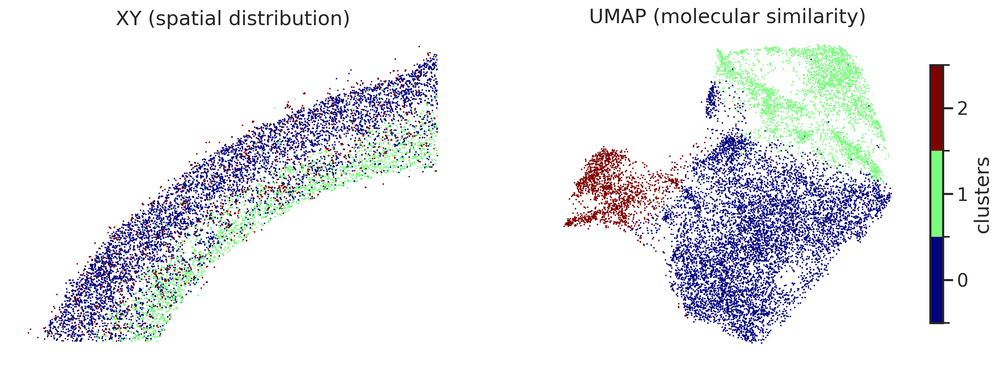

In [150]:
clsts = adatasub4.obs['leiden_r0.2'].astype(int)
x = adatasub4.obs['x']
y = adatasub4.obs['y']
ux = adatasub4.obsm['umap'][:,0]
uy = adatasub4.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, s=2)

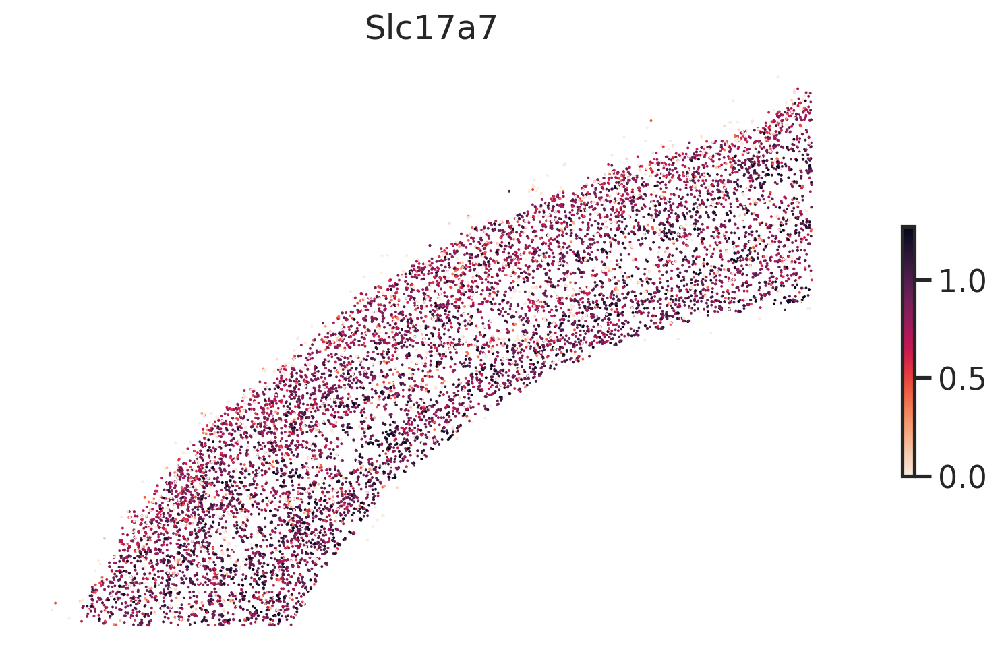

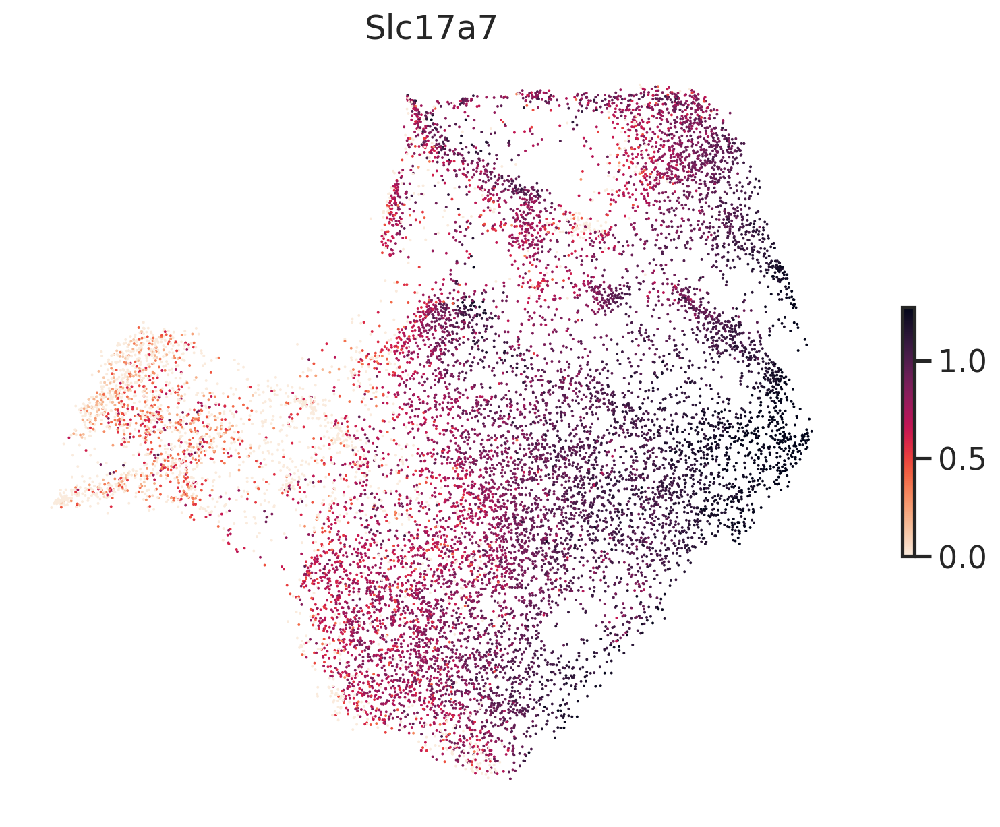

In [152]:
gn = 'Slc17a7'
g = np.log10(1+adatasub4[:,gn].layers['norm'])
st_scatter(x, y, gexp=g, s=2, title=gn)
st_scatter(ux, uy, gexp=g, s=2, title=gn)

# one cluster at a time - and makse sense of them
- pick cluster 0

In [155]:
adatasub5 = adatasub4[adatasub4.obs['leiden_r0.2'].isin(['0', '1'])].copy()
adatasub5

AnnData object with n_obs × n_vars = 11441 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'leiden', 'leiden_r0.1', 'leiden_r0.2', 'leiden_spatial_r0.2', 'leiden_spatial_r0.1', 'leiden_spatial_r0.01', 'leiden_r1', 'leiden_r3', 'leiden_r5'
    uns: 'neighbors', 'leiden'
    obsm: 'blanks', 'X_pca', 'pca', 'umap', 'xy'
    layers: 'normX', 'norm'
    obsp: 'distances', 'connectivities'

In [156]:
pca = PCA(n_components=20)
pcs = pca.fit_transform(adatasub5.layers['norm'])
print(pcs.shape)

ucs = UMAP(n_components=2, n_neighbors=30).fit_transform(pcs)
print(ucs.shape)

(11441, 20)
(11441, 2)


In [157]:
adatasub5.obsm['pca'] = pcs
adatasub5.obsm['umap'] = ucs

In [158]:
sc.pp.neighbors(adatasub5, n_neighbors=30, use_rep='pca')

In [165]:
r = 0.5
sc.tl.leiden(adatasub5, resolution=r, key_added=f'leiden_r{r}')

(<Figure size 1600x600 with 3 Axes>,
 array([<Axes: title={'center': 'XY (spatial distribution)'}>,
        <Axes: title={'center': 'UMAP (molecular similarity)'}>],
       dtype=object))

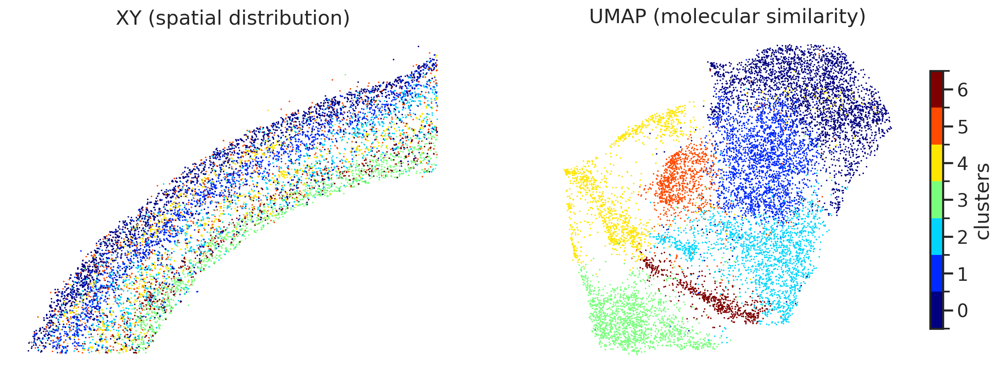

In [166]:
clsts = adatasub5.obs['leiden_r0.5'].astype(int)
x = adatasub5.obs['x']
y = adatasub5.obs['y']
ux = adatasub5.obsm['umap'][:,0]
uy = adatasub5.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, s=2)

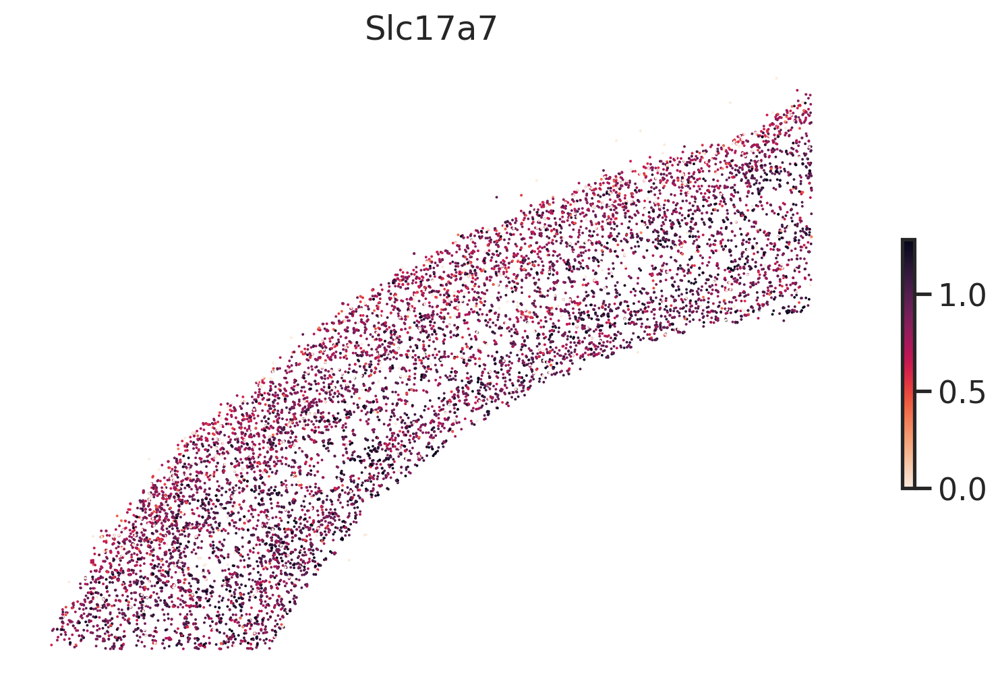

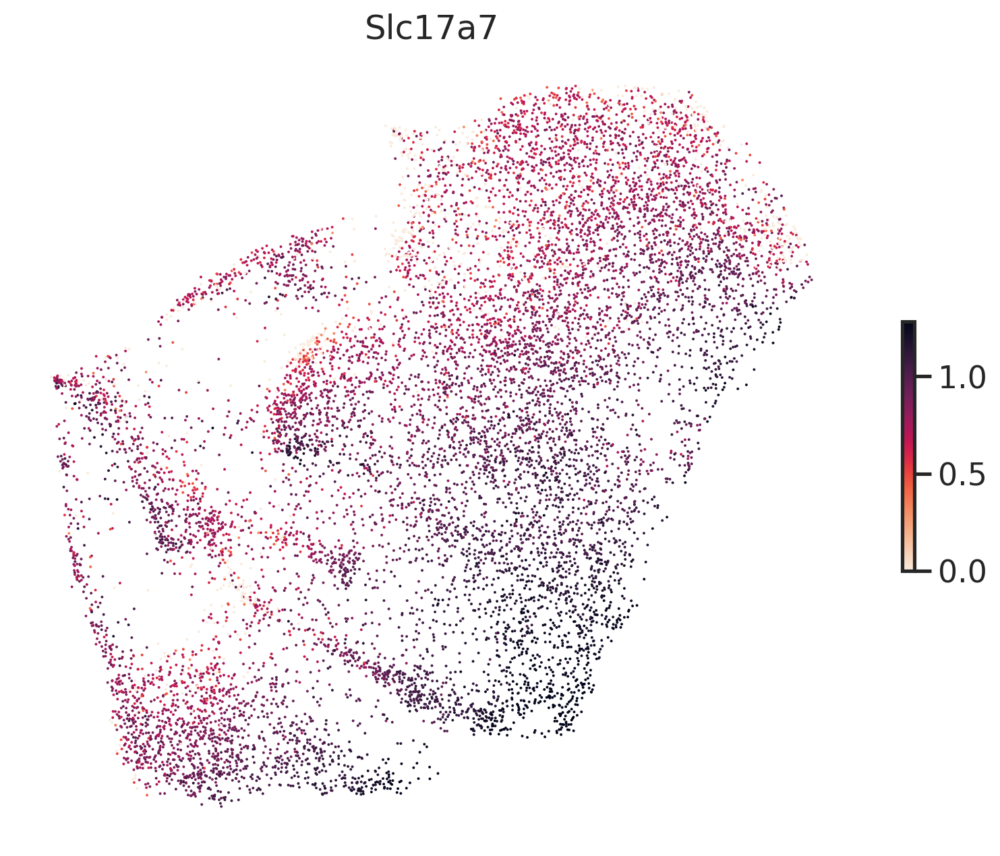

In [167]:
gn = 'Slc17a7'
g = np.log10(1+adatasub5[:,gn].layers['norm'])
st_scatter(x, y, gexp=g, s=2, title=gn)
st_scatter(ux, uy, gexp=g, s=2, title=gn)

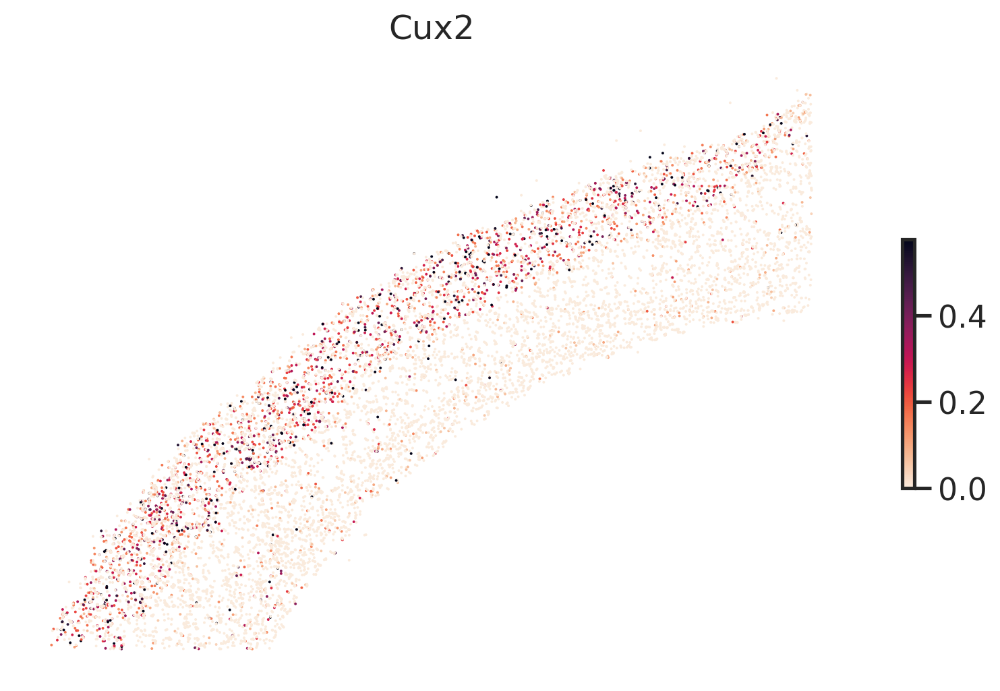

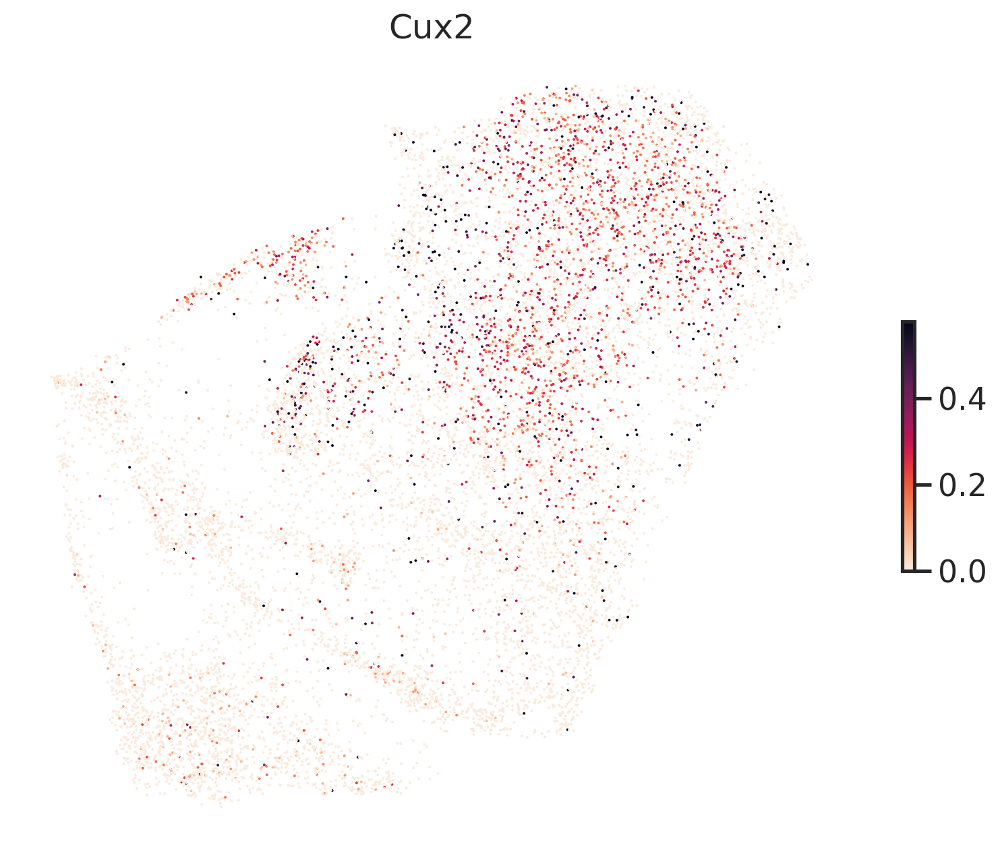

In [169]:
gn = 'Cux2'
g = np.log10(1+adatasub5[:,gn].layers['norm'])
st_scatter(x, y, gexp=g, s=2, title=gn)
st_scatter(ux, uy, gexp=g, s=2, title=gn)

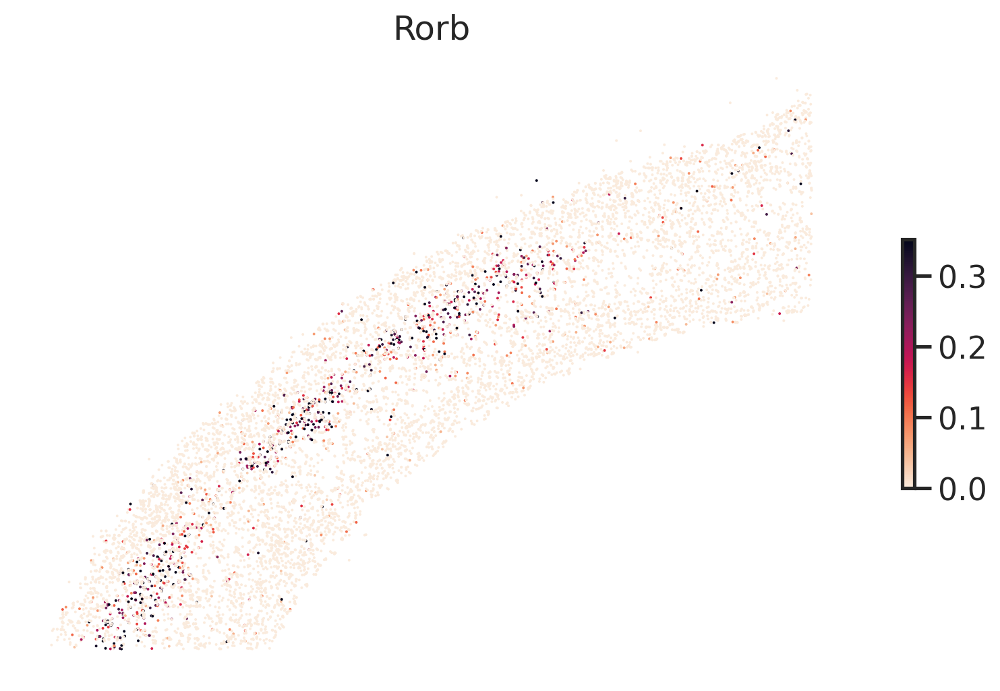

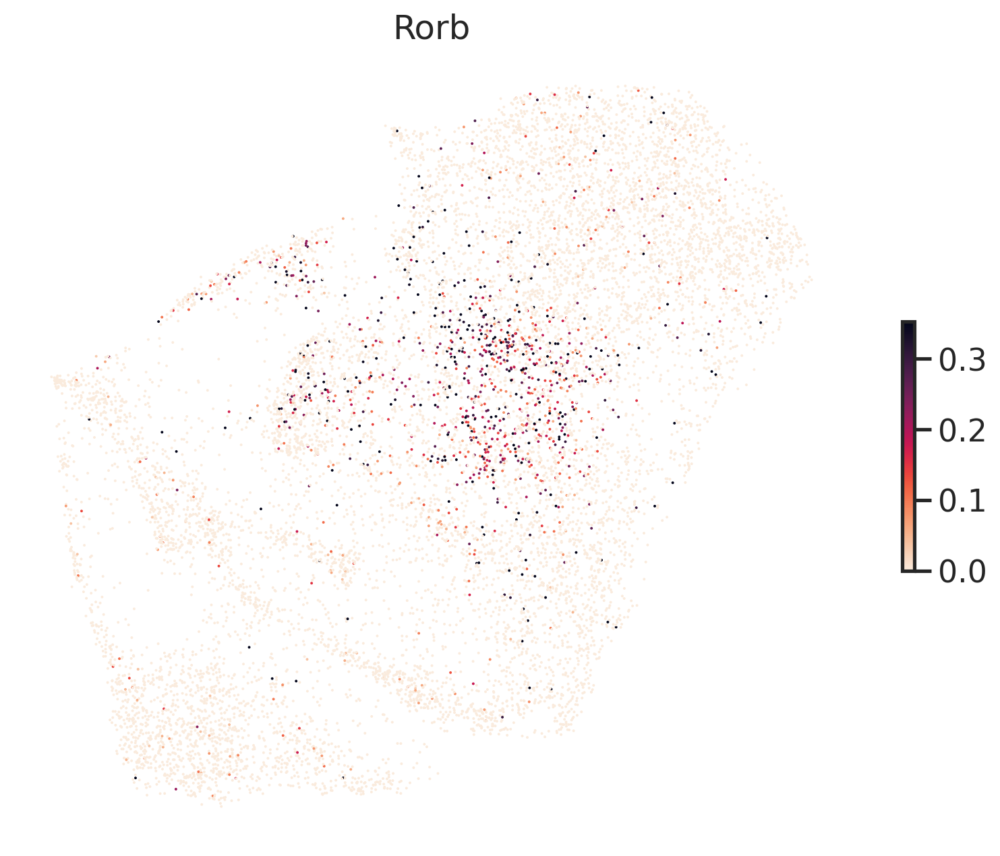

In [168]:
gn = 'Rorb'
g = np.log10(1+adatasub5[:,gn].layers['norm'])
st_scatter(x, y, gexp=g, s=2, title=gn)
st_scatter(ux, uy, gexp=g, s=2, title=gn)

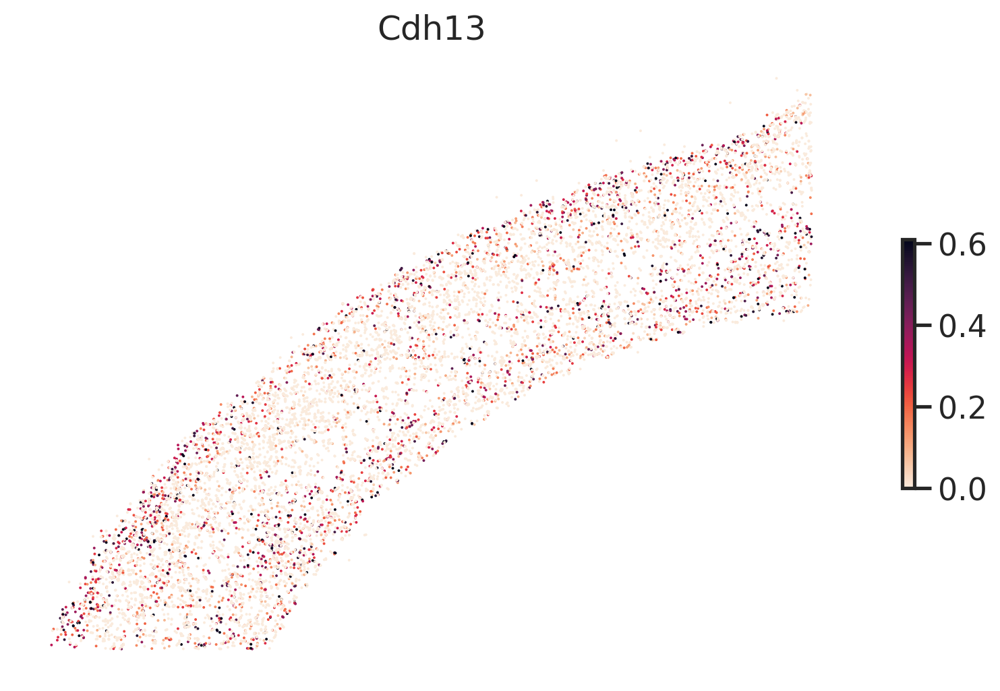

In [172]:
gn = 'Cdh13'
g = np.log10(1+adatasub5[:,gn].layers['norm'])
st_scatter(x, y, gexp=g, s=2, title=gn)
# st_scatter(ux, uy, gexp=g, s=2, title=gn)

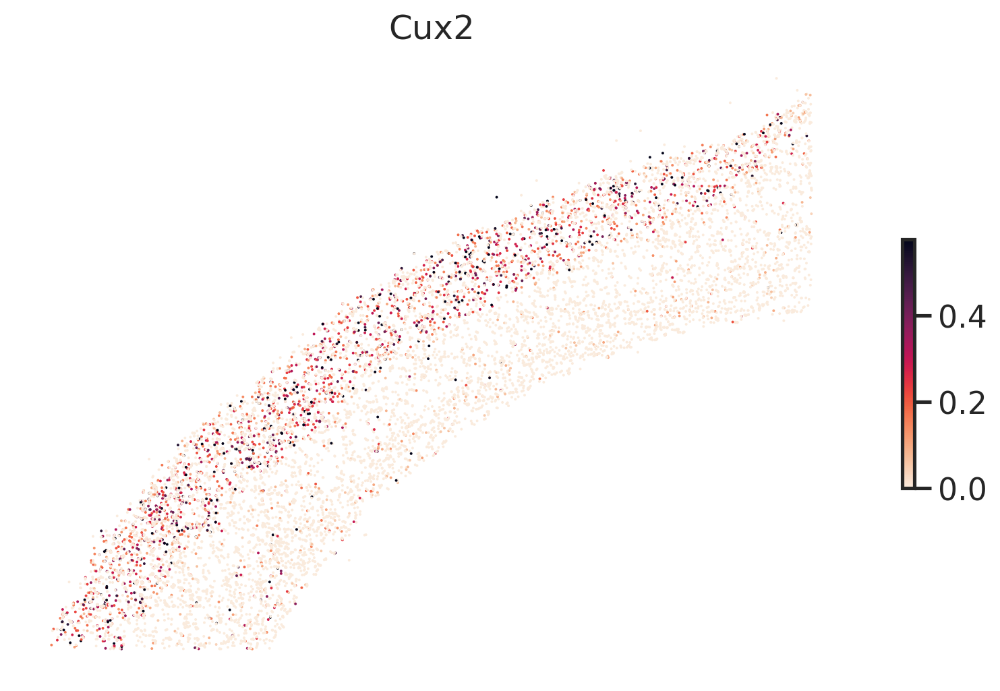

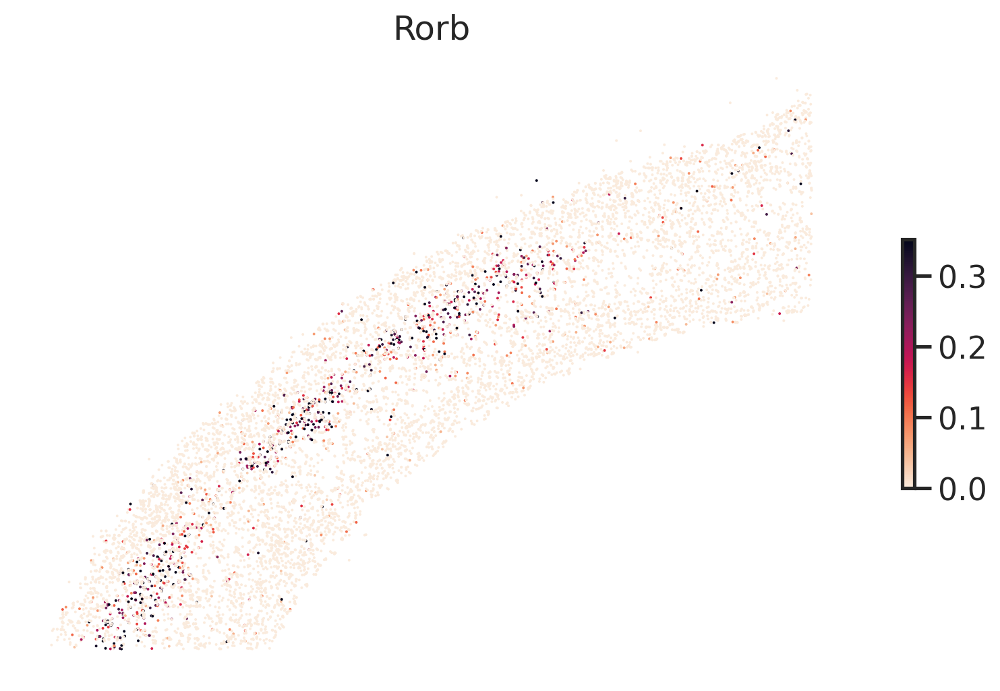

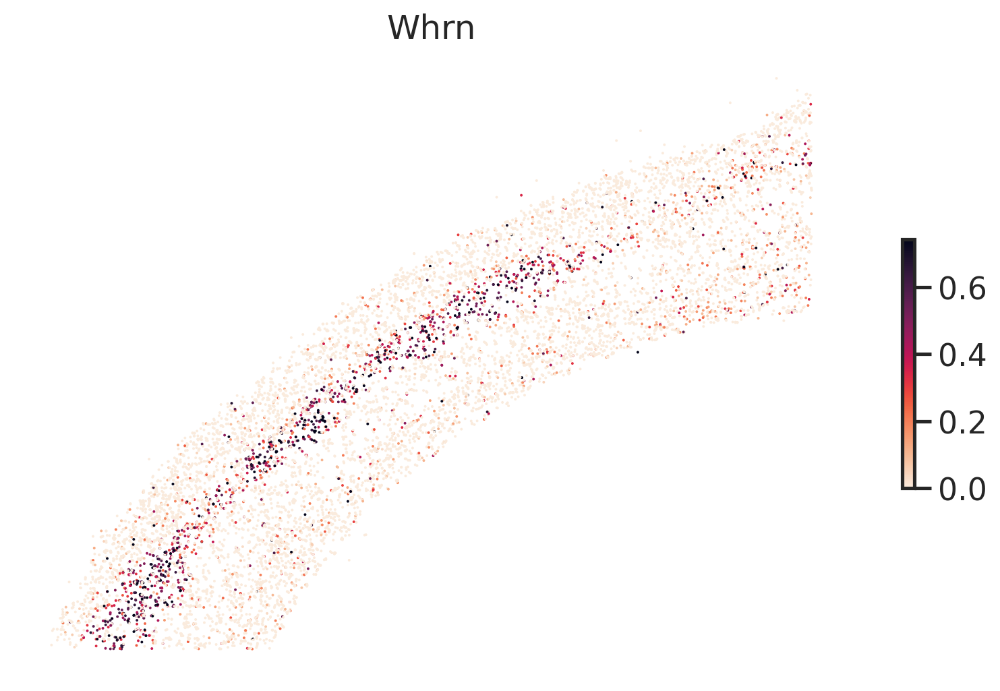

In [180]:

gns = [
    'Cux2',
    'Rorb',
    'Whrn',
]

for gn in gns:
    g = np.log10(1+adatasub5[:,gn].layers['norm'])
    st_scatter(x, y, gexp=g, s=2, title=gn)
    plt.show()
    # plt.close()
    # st_scatter(ux, uy, gexp=g, s=2, title=gn)

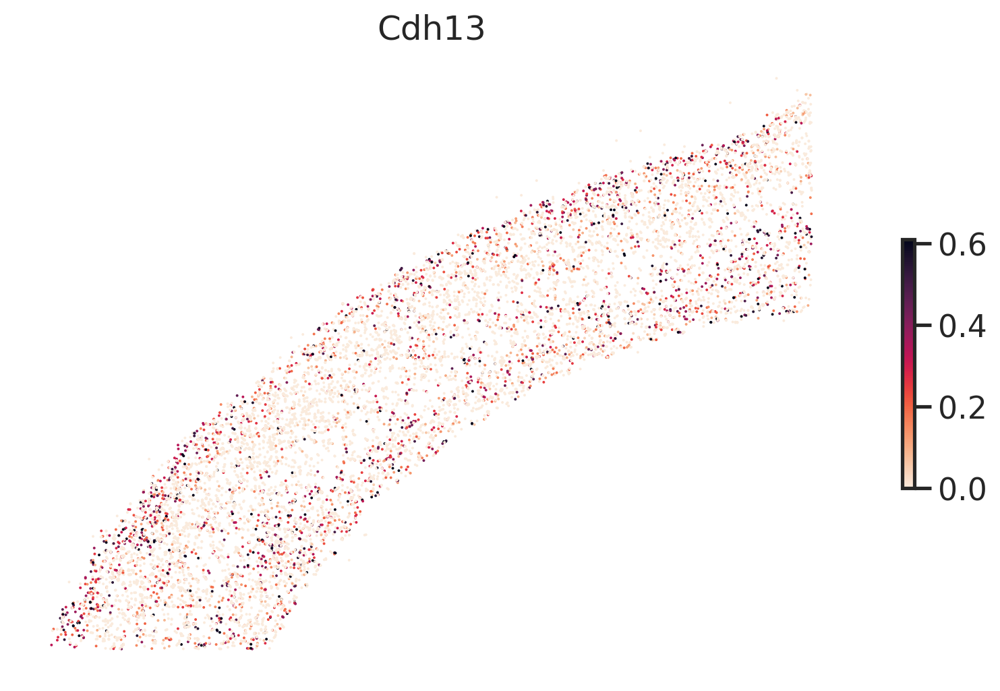

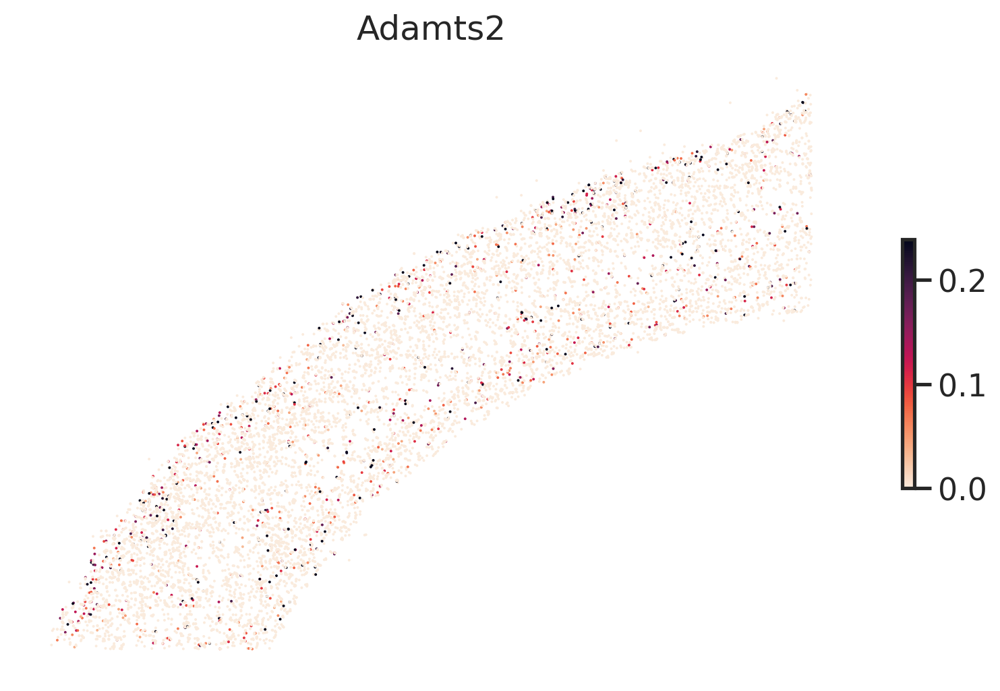

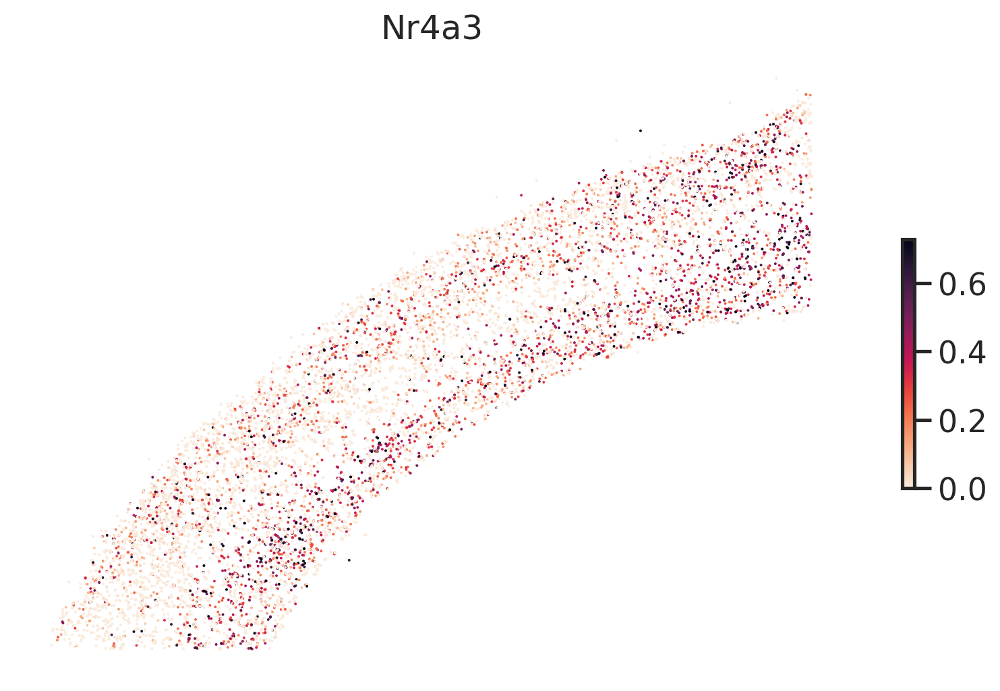

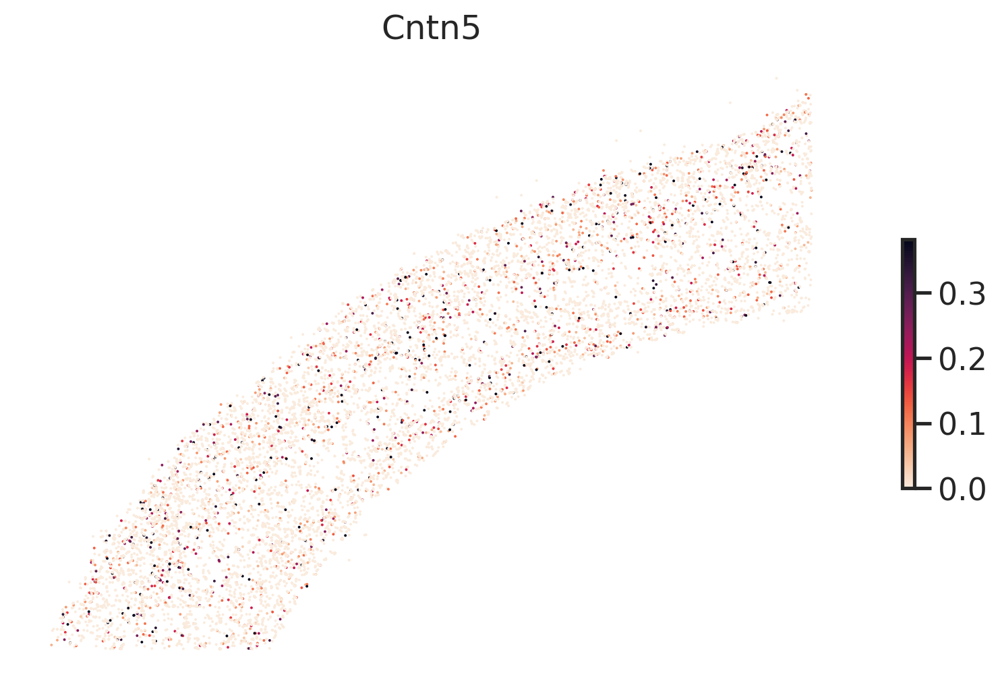

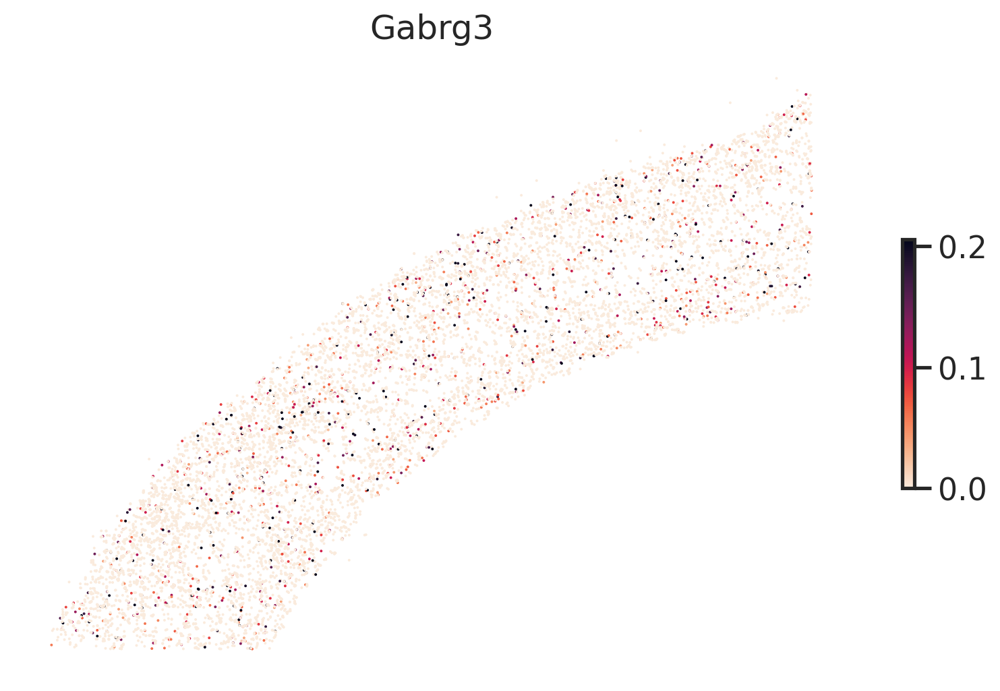

...

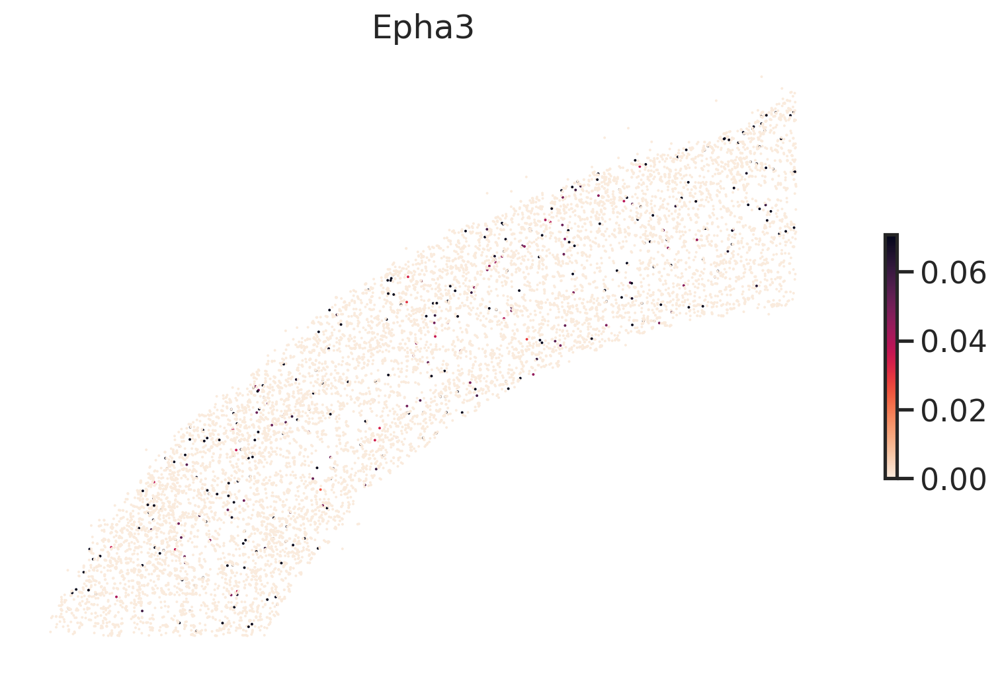

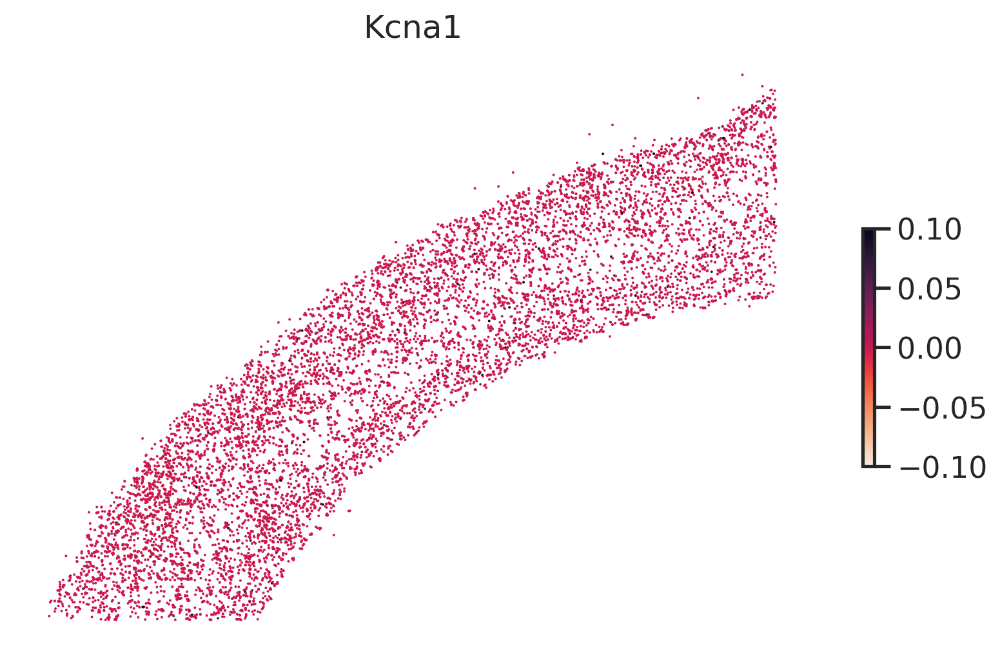

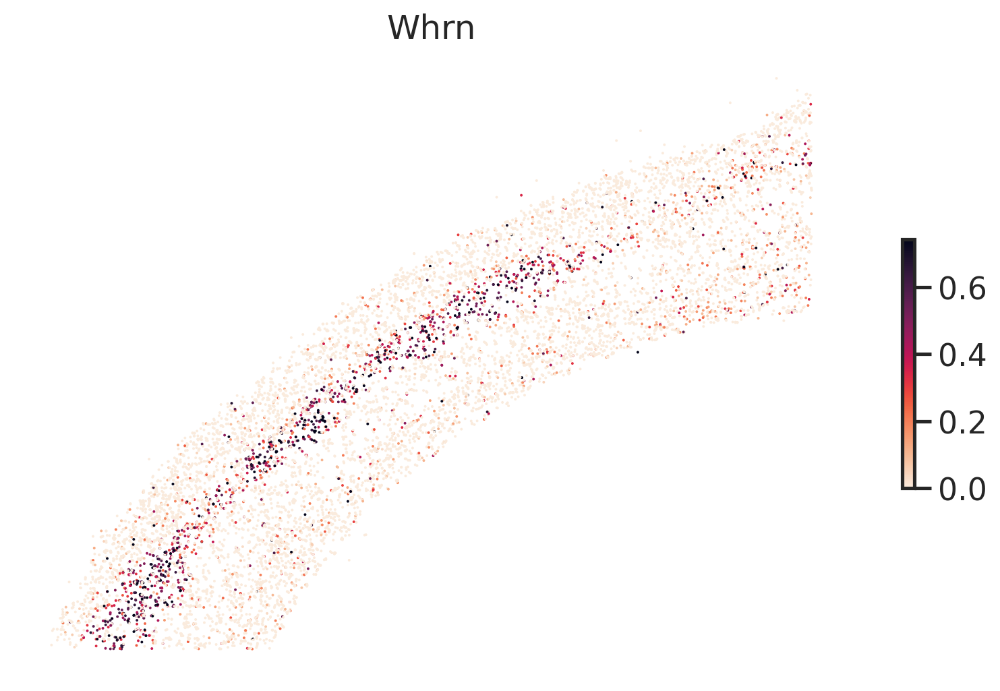

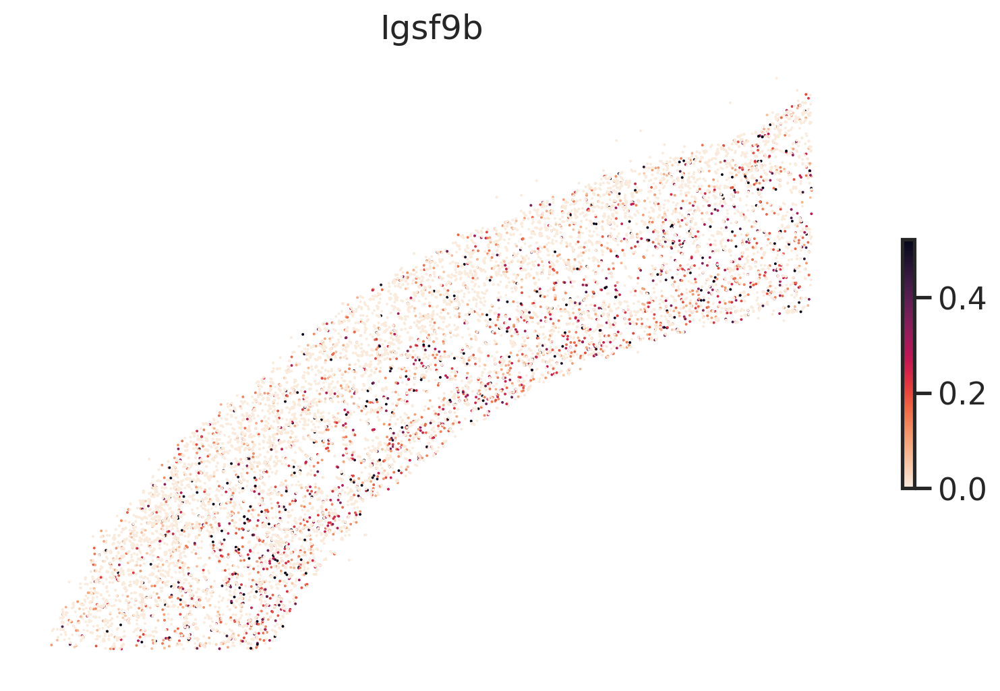

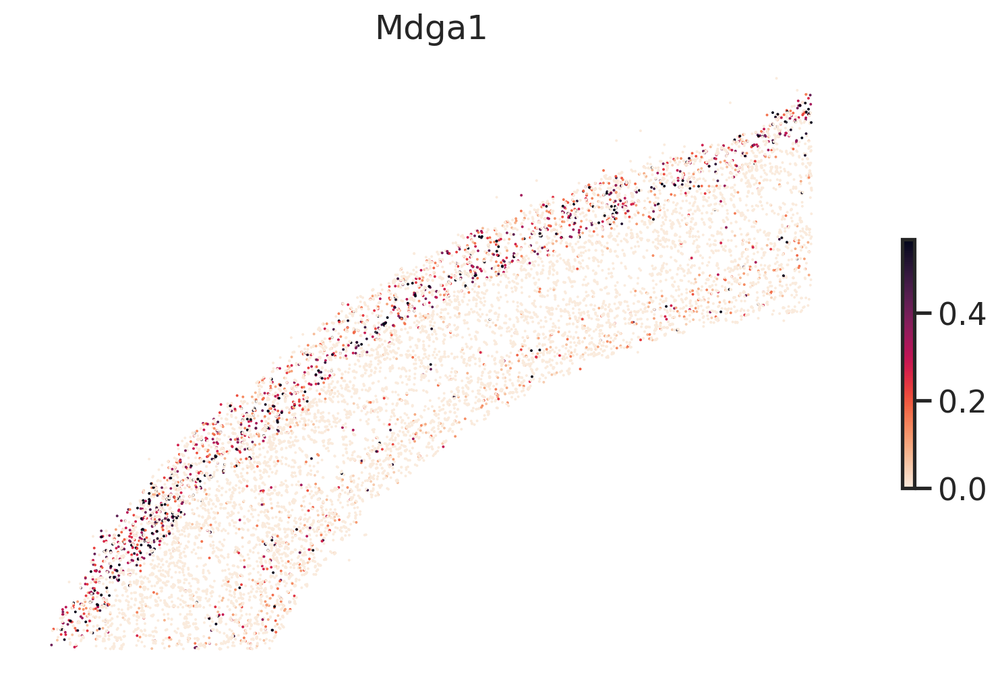

In [179]:

gns = [
    'Cdh13',
    'Adamts2',
    'Nr4a3',
    'Cntn5',
    'Gabrg3',
    'Grm8',
    'Sorcs3',
    'Chrm2',
    'Cdh12',
    'Cntnap2',
    'Kcnh5',
    'Kcnq5',
    'Ncam2',
    'Gria3',
    'Rorb',
    'Kcnip3',
    'Baz1a',
    'Rfx3',
    'Trpc6',
    'Egfem1',
    'Igfn1',
    'Bdnf',
    'Epha3',
    'Kcna1',
    'Whrn',
    'Igsf9b',
    'Mdga1',
]

for gn in gns:
    g = np.log10(1+adatasub5[:,gn].layers['norm'])
    st_scatter(x, y, gexp=g, s=2, title=gn)
    plt.show()
    # plt.close()
    # st_scatter(ux, uy, gexp=g, s=2, title=gn)